In [568]:
from sqlalchemy import create_engine
import pandas as pd
import numpy as np

In [391]:
db_host  = '18.136.157.135'
Username = 'dm_usdata_sql' 
Password = '37z<49REb&mKnl4AV!vJ'
db_name  = 'project_service_data'

conn = create_engine('mysql+pymysql://'+Username+':'+Password+'@'+db_host+'/'+db_name)
conn.table_names()

['service_data']

In [443]:
query = 'select * from service_data'
d= pd.read_sql(query,conn)
d.head()

,invoice_date,job_card_date,business_partner_name,vehicle_no,vehicle_model,current_km_reading,invoice_line_text
0,30-05-17,30-05-17,shivXXXXXXXXXX,KA03MFXXXX,BAJAJ AVENGER STREET 220,50000,ENGINE OIL
1,02-06-17,31-05-17,KIRAXXXXXXXXXX,KA53ESXXXX,BAJAJ PULSAR NS 200,758,ENGINE OIL
2,02-06-17,31-05-17,KIRAXXXXXXXXXX,KA53ESXXXX,BAJAJ PULSAR NS 200,758,POLISH
3,02-06-17,31-05-17,KIRAXXXXXXXXXX,KA53ESXXXX,BAJAJ PULSAR NS 200,758,CONSUMABLES
4,02-06-17,31-05-17,KIRAXXXXXXXXXX,KA53ESXXXX,BAJAJ PULSAR NS 200,758,COOLANT OIL


In [444]:
d.to_excel('raw.xlsx')

In [445]:
d.shape

(28482, 7)

In [446]:
d['vehicle_model'].value_counts()

BAJAJ PULSAR 150            8633
BAJAJ AVENGER STREET 220    4212
BAJAJ PULSAR 220            2655
BAJAJ PULSAR 180            2252
BAJAJ PULSAR NS 200         2204
BAJAJ CT 100                1432
BAJAJ DISCOVER 125          1346
BAJAJ AVENGER STREET        1112
BAJAJ PLATINA                844
BAJAJ V150                   686
BAJAJ DISCOVER               679
BAJAJ PULSAR LS135           520
BAJAJ PULSAR AS 200          421
BAJAJ PULSAR NS 160          364
BAJAJ PULSAR RS 200          322
BAJAJ DISCOVER 150           284
BAJAJ AVENGER STREET 180     122
BAJAJ DISCOVER 135           115
BAJAJ V125                    95
BAJAJ V                       54
BAJAJ CALIBER                 40
BAJAJ XCD 125                 27
BAJAJ V15                     23
BAJAJ XCD 135                 13
WAVE                          10
BAJAJ DOMINAR 400 ABS          7
BAJAJ WIND 125                 6
BAJAJ BOXER CT                 4
Name: vehicle_model, dtype: int64

In [447]:
d.drop(['business_partner_name', 'vehicle_no'],axis=1,inplace=True)

In [448]:
d.columns

Index(['invoice_date', 'job_card_date', 'vehicle_model', 'current_km_reading',
       'invoice_line_text'],
      dtype='object')

In [449]:
d.to_excel('inventory_data.xlsx')

In [450]:
pd.set_option('display.max_rows', None)

In [451]:
d['invoice_line_text'].value_counts()

ENGINE OIL                                        3802
CHAIN LUBRICATION                                 3441
GENERAL SERVICE                                   2142
AIR FILTER                                        1715
3M OIL                                            1628
CONSUMABLES                                       1595
POLISH                                            1245
DISC OIL                                           991
BRAKE SHOE                                         965
OIL FILTER                                         821
DISC PAD                                           575
WHEEL RUBBER                                       521
AIR FILTER CHECKUP                                 467
SPARK PLUG                                         421
CHAIN SPROCKET                                     396
SPROCKET RUBBER                                    347
SPROCKET BEARING                                   314
CHAIN OVERHAUL                                     284
CLUTCH CAB

In [452]:
df['invoice_line_text'].unique().shape

(503,)

# New dataset

In [456]:
data=pd.read_excel("inventory_data.xlsx", index_col='Unnamed: 0')

In [457]:
data.head(2)

,invoice_date,job_card_date,vehicle_model,current_km_reading,invoice_line_text
0,30-05-17,30-05-17,BAJAJ AVENGER STREET 220,50000,ENGINE OIL
1,02-06-17,31-05-17,BAJAJ PULSAR NS 200,758,ENGINE OIL


In [458]:
data.isna().sum()

invoice_date           0
job_card_date          0
vehicle_model          0
current_km_reading     0
invoice_line_text     34
dtype: int64

In [459]:
data.shape

(28482, 5)

In [462]:
df=data[data['invoice_line_text'].isna()==False]

In [464]:
df.isna().sum()

invoice_date          0
job_card_date         0
vehicle_model         0
current_km_reading    0
invoice_line_text     0
dtype: int64

In [466]:
df.shape

(28448, 5)

In [467]:
df['vehicle_model']= df['vehicle_model'].astype('category')

<ipython-input-467-b69a50800379>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['vehicle_model']= df['vehicle_model'].astype('category')


In [468]:
df['invoice_line_text']= df['invoice_line_text'].astype('category')

<ipython-input-468-11d22dcff4e2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['invoice_line_text']= df['invoice_line_text'].astype('category')


In [469]:
df['invoice_date']= pd.to_datetime(df['invoice_date'])

<ipython-input-469-fa182fb41edc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['invoice_date']= pd.to_datetime(df['invoice_date'])


In [470]:
df['job_card_date']= pd.to_datetime(df['job_card_date'])

<ipython-input-470-52242ddc41c4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['job_card_date']= pd.to_datetime(df['job_card_date'])


In [471]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28448 entries, 0 to 28481
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   invoice_date        28448 non-null  datetime64[ns]
 1   job_card_date       28448 non-null  datetime64[ns]
 2   vehicle_model       28448 non-null  category      
 3   current_km_reading  28448 non-null  int64         
 4   invoice_line_text   28448 non-null  category      
dtypes: category(2), datetime64[ns](2), int64(1)
memory usage: 997.7 KB


In [473]:
df.groupby(['invoice_date','invoice_line_text']).size()

invoice_date  invoice_line_text                             
2017-01-06    10 SIZE NUT                                        0
              12 SIZE BOLT                                       0
              3M OIL                                             5
              4 WAY SWITCH                                       0
              6004 BEARING                                       0
              6202 BEARING                                       0
              6303 BEARING                                       0
              8 SIZE BOLT                                        0
              ACCELATOR CABLE                                    0
              ADD ON FEES                                        0
              AIR FILTER                                         0
              AIR FILTER CHECKUP                                 3
              AIR INTAKE                                         0
              AXLE                                               0
 

In [474]:
inventory = df['invoice_line_text'].value_counts()
i= 0
for item, count in inventory.iteritems():
    if item.upper().find('OVERHUAL') != -1:
        i += 1
        print(i, item, count)
    if item.upper().find('OVERHAUL') != -1:
        i += 1
        print(i, item, count)

1 CHAIN OVERHAUL 284
2 CLUTCH OVERHUAL 163
3 DISC OVERHUAL 79
4 FORK OVERHUAL 72
5 TIMMING CHAIN OVERHUAL 4
6 MAGNET OVERHUAL 2
7 COIL OVERHUAL 1
8 CONE SET OVERHUAL 1
9 RADIATOR OVERHUAL 1
10 FUEL GUAGE OVERHUAL 1
11 ENGINE OVERHUAL 1


In [291]:
labels_to_delete = ['CHARGE', 'INSURANCE', 'PAYMENT', 'REGISTER*', 'ADJUSTMENT', 'WELDING', 
                    'REMOVAL', 'THREADING', 'CLEANING', 'FEES', 'REBORE', 'PUNCHER', 'EX SHOW ROOM', 
                    'DENT', 'RC CARD', 'TAX', 'ENGINE WORK', 'SERVICE', 'CHECK']

In [298]:
data.iloc[400:550,:]

,invoice_date,job_card_date,vehicle_model,current_km_reading,invoice_line_text
474,2017-10-06,2017-10-06,BAJAJ PULSAR 150,18595,VISIOR
476,2017-10-06,2017-10-06,BAJAJ PULSAR 150,18595,CHAIN SET
477,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,PETROL TUBE
478,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,DRUM BOLT WASHER
479,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,TANK COVER
480,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,WHEEL RUBBER
481,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,REAR CALIPER ASSEMBLY
482,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,DISC PAD
483,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,CHAIN SPROCKET
484,2017-10-06,2017-10-06,BAJAJ PULSAR 220,0,CHAIN OVERHAUL


In [476]:
for index, text in df['invoice_line_text'].iteritems():
    if text == 'SERVICE AND ONE WAY CLUTCH BUSH KIT':
        print('Changed the text from "SERVICE AND ONE WAY CLUTCH BUSH KIT" to "SERVICE AND ONE WAY CLUTCH BUSH KIT"')
        df.loc[index, 'invoice_line_text'] = 'ONE WAY CLUTCH BUSH KIT'
    
    if text == 'NUMBER PLATE WITH STICKER':
        print('Changed the text from "NUMBER PLATE WITH STICKER" to "NUMBER PLATE"')
        df.loc[index, 'invoice_line_text'] = 'NUMBER PLATE'
        
    if text == 'VISIOR WITH LABOUR':
        print('Changed the text from "VISIOR WITH LABOUR" to "VISIOR"')
        df.loc[index, 'invoice_line_text'] = 'VISIOR'
                
    if text.strip() == 'PETROL':
        print('Deleting line that has PETROL only')
        df.drop(index=index, inplace=True)
    if text.upper().find('OVERHUAL') != -1:
        print('Deleting line with text : ', text)
        df.drop(index=index, inplace=True)
        
    if item.upper().find('OVERHAUL') != -1:  #Minor spelling change in data
        i += 1
        print(i, item, count)
        
    for del_str in labels_to_delete:
        if text.upper().find(del_str) != -1:
            print('Deleting line with text : ', text)
            df.drop(index=index, inplace=True)

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BRAKE ADJUSTMENT
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BRAKE ADJUSTMENT
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  TANK CLEANING
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CARBURETOR CLEANING
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BRAKE ADJUSTMENT
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BRAKE ADJUSTMENT
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  BRAKE ADJUSTMENT
Deleting line with text :  T

A:\anaconda\lib\site-packages\pandas\core\frame.py:3990: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


 GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  BATTERY CHARGE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  WIRING CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line wi

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR 

Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Del

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  TANK CLEANING
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line that has PETROL only
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with te

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENER

Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  PUNCHER
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting 

Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  RC CARD
Deleting line with text :  RC CARD
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with t

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BATTERY CHARGE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
De

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  ENGINE WORK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  WIRING CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  BATTERY CHARGE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line 

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line that has PETROL only
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  COIL CHECK
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENER

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  DISC OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  COIL CHECK
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleti

Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  FORK OVERHUAL
Deleting line with text :  AIR FILTER CHECKUP
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  GENERAL SERVICE
Deleting line with text :  CLUTCH OVERHUAL
Deleting line with text :  GENERAL SERVICE
Deleting lin

In [494]:
df.shape

(25305, 5)

In [478]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
#sns.set(style='darkgrid')
from matplotlib import rcParams

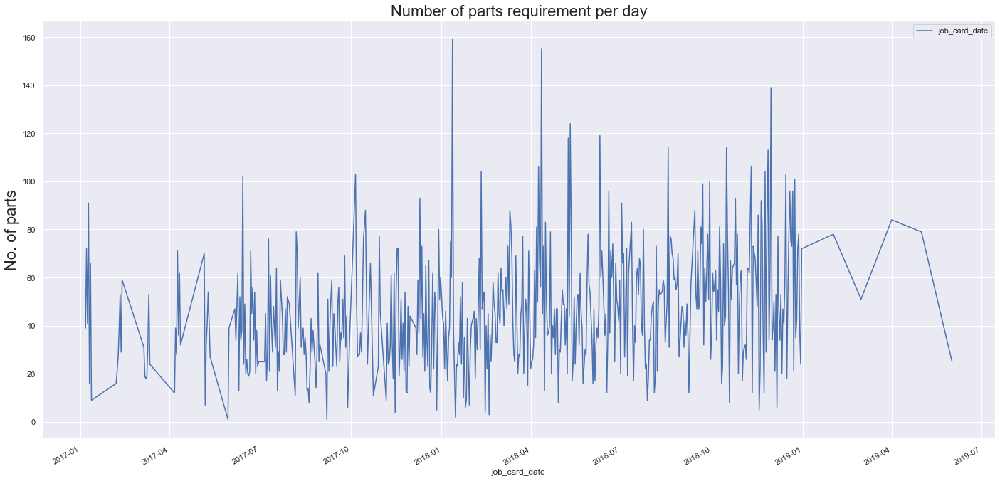

In [479]:
plt.rcParams['figure.figsize'] = (24,12)
df.groupby(['job_card_date'])['job_card_date'].count().to_frame().plot()
plt.title('Number of parts requirement per day', fontdict={'fontsize':22})
plt.ylabel('No. of parts', fontdict={'fontsize':22});


A:\anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


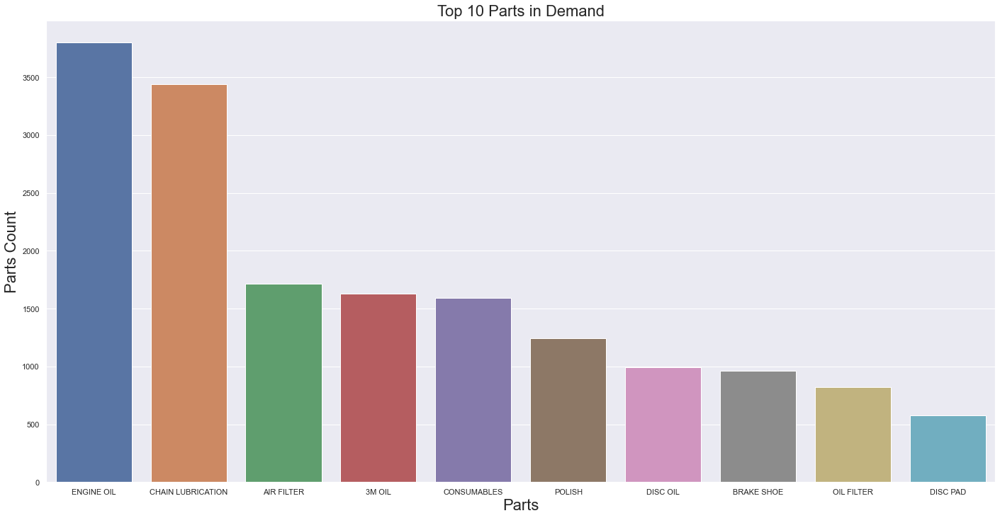

In [480]:
sns.set(style='darkgrid')
sns.countplot(df['invoice_line_text'], order=df['invoice_line_text'].value_counts().index[:10])
plt.title('Top 10 Parts in Demand', fontdict={'fontsize':22});
plt.ylabel('Parts Count', fontdict={'fontsize':22});
plt.xlabel('Parts', fontdict={'fontsize':22});

In [487]:
df1 = df[['job_card_date', 'invoice_line_text']]

In [488]:
df1.columns

Index(['job_card_date', 'invoice_line_text'], dtype='object')

In [490]:
df1 = df1.rename({ 'job_card_date':'Date', 'invoice_line_text':'Item'}, axis='columns')

In [491]:
df1.head()

,Date,Item
0,2017-05-30,ENGINE OIL
1,2017-05-31,ENGINE OIL
2,2017-05-31,POLISH
3,2017-05-31,CONSUMABLES
4,2017-05-31,COOLANT OIL


In [493]:
df1.shape

(25305, 2)

In [492]:
df1.Item.value_counts().sum()

25305

In [495]:
( df1.Item.value_counts()[0:20].sum() * 100 ) / df1.Item.value_counts().sum()

78.48251333728513

In [496]:
df1.set_index('Date', inplace=True)

In [497]:
df1.to_excel('Cleaned_df.xlsx')

# Cleaned data

In [569]:
df = pd.read_excel('Cleaned_df.xlsx', index_col = 'Date')

In [499]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 25305 entries, 2017-05-30 to 2019-06-01
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Item    25305 non-null  object
dtypes: object(1)
memory usage: 395.4+ KB


In [570]:
df.head()

,Item
Date,
2017-05-30,ENGINE OIL
2017-05-31,ENGINE OIL
2017-05-31,POLISH
2017-05-31,CONSUMABLES
2017-05-31,COOLANT OIL


In [501]:
inventory = df.copy()

In [502]:
WeekCount = inventory['Item'].resample('W').count()

In [503]:
WeekCount.size

126

In [504]:
import matplotlib.pyplot as plt

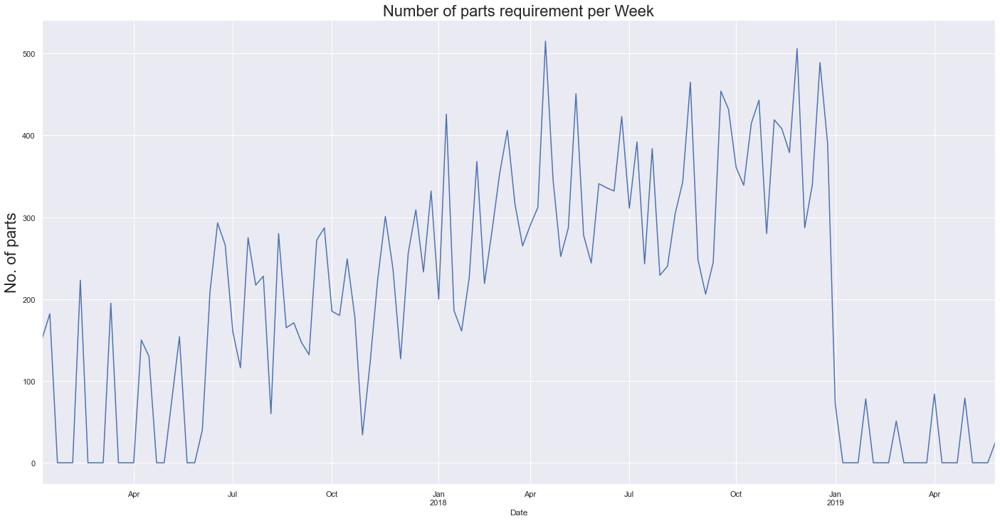

In [505]:
plt.rcParams['figure.figsize'] = (24,12)
WeekCount.plot();
plt.title('Number of parts requirement per Week', fontdict={'fontsize':22})
plt.ylabel('No. of parts', fontdict={'fontsize':22});

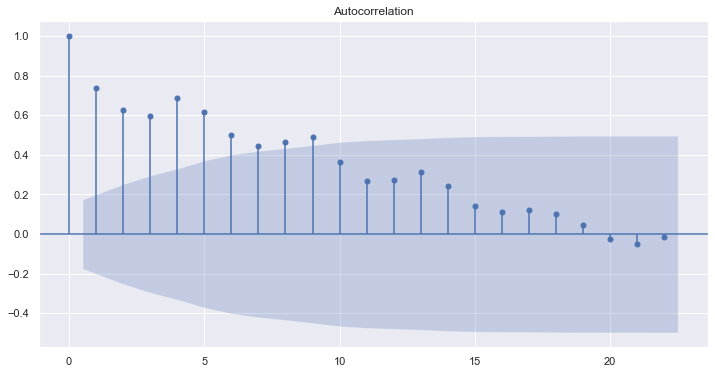

In [506]:
plt.rcParams['figure.figsize'] = (12,6)
from statsmodels.graphics.tsaplots import plot_acf
plot_acf(WeekCount);

In [507]:
WeekCount_diff = WeekCount.diff(periods=1)
#Integraded orde of 1, denoted by d(for difference), one of the parameter of ARIMA mode
WeekCount_diff = WeekCount_diff[1:]

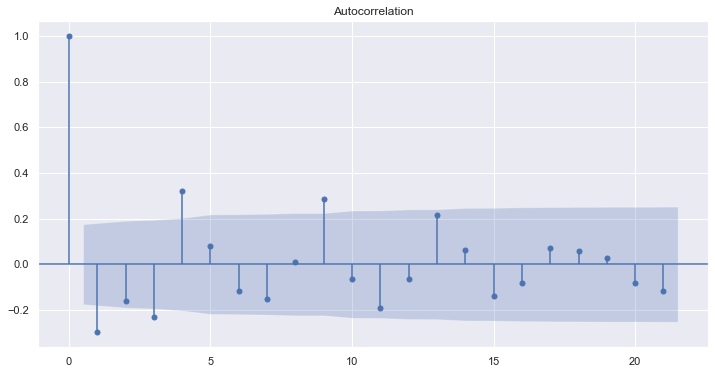

In [508]:
plot_acf(WeekCount_diff);

In [541]:
X = WeekCount.values

train = X[:100] 
test = X[100:]
predictions = []

In [542]:
print('train data length : ', len(train))
print('test  data length : ', len(test))

train data length :  100
test  data length :  26


In [543]:
from statsmodels.tsa.arima_model import ARIMA
model_arima = ARIMA(train, order=(3,1,1))
model_arima_fit = model_arima.fit()
print(model_arima_fit.aic)

1162.5870090588123


In [549]:
 predictions = model_arima_fit.forecast(steps=26)[0]
predictions

array([429.61561656, 423.7882915 , 407.03012241, 462.21770019,
       459.34932913, 451.60187247, 437.0953799 , 456.08399494,
       467.38875894, 469.62112598, 462.47638071, 466.98890639,
       475.69371698, 481.99389001, 481.57111108, 482.84114437,
       487.72469803, 493.71463527, 496.77068618, 498.69413851,
       501.87055867, 506.51942821, 510.56856215, 513.55890001,
       516.5177517 , 520.27198808])

In [550]:
from sklearn.metrics import mean_squared_error


In [551]:
mean_squared_error(test, predictions)

186406.76822583226

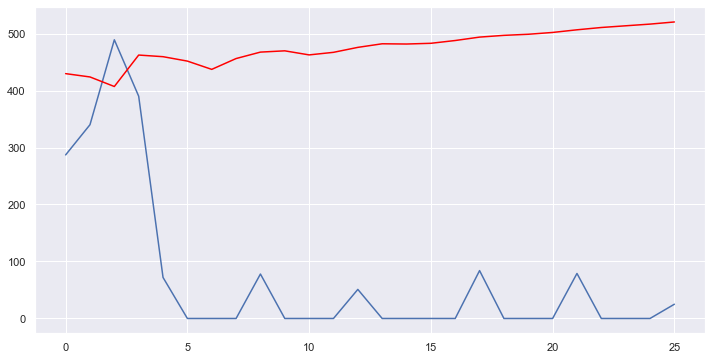

In [552]:
plt.plot(test)
plt.plot(predictions, color='red')

In [553]:
import itertools 
p=q=range(0,10)
d = range(2,6)
pdq = list(itertools.product(p,d,q))

In [554]:
import warnings
warnings.filterwarnings('ignore')
lowest_aic = 10000
for param in pdq:
    try:
        model_arima = ARIMA(train, order=param)
        model_arima_fit = model_arima.fit()
        if model_arima_fit.aic < lowest_aic:
            lowest_aic = model_arima_fit.aic
        print(param, model_arima_fit.aic, lowest_aic)
    except:
        continue

(0, 2, 0) 1302.6131409322893 1302.6131409322893
(0, 2, 1) 1212.5551157230097 1212.5551157230097
(0, 2, 2) 1170.2357561238769 1170.2357561238769
(0, 2, 3) 1170.316271507211 1170.2357561238769
(0, 2, 5) 1164.2678360780528 1164.2678360780528
(0, 2, 7) 1162.1230003173087 1162.1230003173087
(1, 2, 0) 1265.215636808089 1162.1230003173087
(2, 2, 0) 1257.793063480837 1162.1230003173087
(3, 2, 0) 1213.0684484680623 1162.1230003173087
(3, 2, 1) 1161.4770084332065 1161.4770084332065
(3, 2, 2) 1160.9475670389659 1160.9475670389659
(4, 2, 0) 1189.4618603811123 1160.9475670389659
(4, 2, 1) 1160.869916621325 1160.869916621325
(4, 2, 2) 1162.1024315845923 1160.869916621325
(4, 2, 3) 1163.8880412476447 1160.869916621325
(5, 2, 0) 1187.292806527506 1160.869916621325
(5, 2, 1) 1162.735266527919 1160.869916621325
(5, 2, 2) 1163.9601102067595 1160.869916621325
(5, 2, 3) 1160.9727407103837 1160.869916621325
(6, 2, 0) 1185.144886721694 1160.869916621325
(6, 2, 1) 1162.9339817502691 1160.869916621325
(6, 2, 2

In [556]:
model_arima = ARIMA(train, order=(6,2,2))
model_arima_fit = model_arima.fit()

predictions = model_arima_fit.forecast(steps=26)[0]
predictions

array([392.59265285, 409.75458678, 360.42066876, 414.54470177,
       397.62266145, 377.97920708, 367.7284097 , 380.62755927,
       392.2656743 , 378.16660061, 370.10472933, 373.03050623,
       382.06702055, 378.1394935 , 370.1365553 , 369.06800252,
       373.52737227, 373.7196602 , 368.39858508, 365.39831373,
       366.75944933, 367.60882533, 364.71395037, 361.45372806,
       360.86091738, 361.16297943])

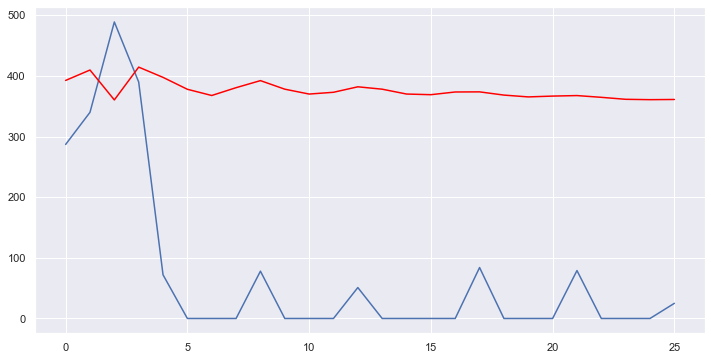

In [557]:
plt.plot(test)
plt.plot(predictions, color='red')

In [558]:
inventory.head()

,Item
Date,
2017-05-30,ENGINE OIL
2017-05-31,ENGINE OIL
2017-05-31,POLISH
2017-05-31,CONSUMABLES
2017-05-31,COOLANT OIL


In [559]:
inventory.Item.value_counts()[0:9].index

Index(['ENGINE OIL', 'CHAIN LUBRICATION', 'AIR FILTER', '3M OIL',
       'CONSUMABLES', 'POLISH', 'DISC OIL', 'BRAKE SHOE', 'OIL FILTER'],
      dtype='object')

In [560]:
import re
itemGroups = []
dfGroupObj = inventory.groupby('Item')
for item in inventory.Item.value_counts()[0:9].index:
    modItem = item.replace(' ', '_')
    print(item, 'File Name : ', modItem)
    tempDf = dfGroupObj.get_group(item).resample('W').count()
    itemGroups.append(tempDf)
    tempDf.to_excel(modItem + '.xlsx')

ENGINE OIL File Name :  ENGINE_OIL
CHAIN LUBRICATION File Name :  CHAIN_LUBRICATION
AIR FILTER File Name :  AIR_FILTER
3M OIL File Name :  3M_OIL
CONSUMABLES File Name :  CONSUMABLES
POLISH File Name :  POLISH
DISC OIL File Name :  DISC_OIL
BRAKE SHOE File Name :  BRAKE_SHOE
OIL FILTER File Name :  OIL_FILTER


In [561]:
itemGroups[0].Item.values

array([26, 21,  0,  0,  0, 43,  0,  0,  0, 34,  0,  0,  0, 24, 22,  0,  0,
       10, 27,  0,  0,  7, 40, 44, 45, 27, 21, 48, 38, 38,  8, 37, 29, 29,
       21, 24, 48, 55, 29, 22, 44, 30,  5, 21, 38, 45, 41, 21, 39, 58, 45,
       49, 37, 57, 36, 25, 40, 54, 38, 51, 56, 56, 52, 45, 46, 52, 69, 52,
       44, 49, 51, 47, 46, 55, 52, 43, 58, 48, 66, 32, 50, 35, 38, 42, 49,
       59, 34, 36, 30, 51, 53, 65, 45, 56, 51, 39, 57, 59, 45, 59, 41, 42,
       53, 56,  9,  0,  0,  0,  6,  0,  0,  0,  6,  0,  0,  0,  0, 11,  0,
        0,  0, 11,  0,  0,  0,  4], dtype=int64)

In [562]:
X = itemGroups[0].values

traindata = X[:100] #70 data as train
test_data = X[100:] #14 data as test
predictions = []


In [563]:
print('train data length : ', len(traindata))
print('test  data length : ', len(test_data))

train data length :  100
test  data length :  26


In [564]:
import itertools 
p=q=range(0,10)
d = range(2,6)
pdq = list(itertools.product(p,d,q))

In [565]:
import warnings
warnings.filterwarnings('ignore')
lowest_aic = 10000 #setting initial value to a large value
for param in pdq:
    try:
        model_arima = ARIMA(traindata, order=param)
        model_arima_fit = model_arima.fit()
        if model_arima_fit.aic < lowest_aic:
            lowest_aic = model_arima_fit.aic
        print(param, model_arima_fit.aic, lowest_aic)
    except:
        continue

(0, 2, 0) 922.8631366928338 922.8631366928338
(0, 2, 1) 833.8389373929563 833.8389373929563
(0, 2, 2) 797.8151619070945 797.8151619070945
(0, 2, 3) 795.7889308529243 795.7889308529243
(0, 2, 5) 791.8591602849087 791.8591602849087
(0, 2, 7) 789.685557302839 789.685557302839
(1, 2, 0) 886.2662774145363 789.685557302839
(1, 2, 4) 795.0184429305323 789.685557302839
(2, 2, 0) 879.5646787773358 789.685557302839
(2, 2, 4) 791.3307324017569 789.685557302839
(3, 2, 0) 833.9239010753231 789.685557302839
(3, 2, 1) 786.7309559902501 786.7309559902501
(3, 2, 2) 787.9899250499152 786.7309559902501
(3, 2, 5) 784.4914532711609 784.4914532711609
(4, 2, 0) 811.9105158975756 784.4914532711609
(4, 2, 1) 787.8319852913212 784.4914532711609
(4, 2, 2) 786.393763944735 784.4914532711609
(4, 2, 3) 788.2699459359385 784.4914532711609
(4, 2, 4) 793.2636847891647 784.4914532711609
(4, 2, 6) 789.8496515358192 784.4914532711609
(4, 2, 7) 783.9660344473377 783.9660344473377
(5, 2, 0) 811.376241067745 783.96603444733

In [566]:
model_arima = ARIMA(traindata, order=(4,2,7))
model_arima_fit = model_arima.fit()

predictions = model_arima_fit.forecast(steps=26)[0]
predictions

array([54.55857009, 44.44837614, 45.29563242, 53.69729182, 52.13568747,
       44.28011302, 43.29115965, 46.9889605 , 53.25999611, 46.88588351,
       43.08938224, 42.02055296, 49.29471227, 48.9216405 , 44.30246628,
       40.16046577, 43.41858277, 47.81607293, 45.51251305, 40.72764994,
       38.96606645, 43.71283872, 45.02593275, 41.94578912, 37.3030699 ,
       38.79023076])

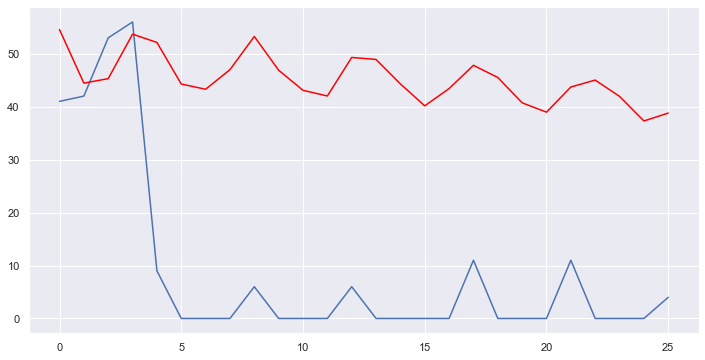

In [567]:
plt.plot(test_data)
plt.plot(predictions, color='red');